<a href="https://colab.research.google.com/github/pipeillera/Incorpus/blob/master/infobotResearch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Author: [Ramsri Goutham](https://twitter.com/ramsri_goutham)

Video Walkthrough: https://www.youtube.com/watch?v=3XlbswJm7Yg

## OpenAI Setup

In [ ]:
from getpass import getpass
openaikey = getpass('Enter the openai key: ')

Enter the openai key: ··········


In [ ]:
chatgpt_url = "https://api.openai.com/v1/chat/completions"
chatgpt_headers = {
    "content-type": "application/json",
    "Authorization":"Bearer {}".format(openaikey)}

In [ ]:
!pip install --quiet ipython-autotime
%load_ext autotime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 6.9 MB/s eta 0:00:00
time: 461 µs (started: 2023-11-29 05:36:26 +00:00)


## 1. Get image description and script using OpenAI

In [ ]:
import requests
import json
from pprint import pprint

def fetch_imagedescription_and_script(prompt,url,headers):

    # Define the payload for the chat model
    messages = [
        {"role": "system", "content": "You are an expert short form video script writer for Instagram Reels and Youtube shorts."},
        {"role": "user", "content": prompt}
    ]

    chatgpt_payload = {
        "model": "gpt-3.5-turbo-16k",
        "messages": messages,
        "temperature": 1.3,
        "max_tokens": 2000,
        "top_p": 1,
        "stop": ["###"]
    }

    # Make the request to OpenAI's API
    response = requests.post(url, json=chatgpt_payload, headers=headers)
    response_json = response.json()

    # Extract data from the API's response
    output = json.loads(response_json['choices'][0]['message']['content'].strip())
    pprint (output)
    image_prompts = [k['image_description'] for k in output]
    texts = [k['text'] for k in output]

    return image_prompts, texts




time: 1.39 ms (started: 2023-08-27 10:38:22 +00:00)


In [ ]:
# Daily motivation, personal growth and positivity

topic = "Tesla's Union Battle Rages On: A Look at the Stock Market Reaction"
goal = "inform people about tech stocks"

# topic = "Morning afformations"
# goal = "Encourage viewers to start their day with a positive mindset."

# topic = "Self-Care and Wellness"
# goal = "offer tips and reminders for self-care practices, stress reduction, and maintaining overall well-being"

# topic = "Gratitude and Positivity"
# goal = "emphasize gratitude and positive thinking"

# topic = "Boost Confidence"
# goal = "help build self-confidence and self-esteem"

# topic = "Happiness and Joy"
# goal = "help people find happiness in simple moments and enjoy life's journey"

# topic = "Resilience and Adversity"
# goal = "help build resilience in the face of adversity"

# topic = "Relationships and Connections"
# goal = "help build meaningful relationships, foster connections, and spread love"

# topic = "Mindfulness and Presence"
# goal = "encourage mindfulness and being present in the moment"

# topic = "Empowerment"
# goal = "empower viewers to take control of their lives, make positive choices, and pursue their dreams"

# topic = "Time Management and Productivity"
# goal = "provide tips about managing time effectively, staying organized, and being productive"

prompt_prefix = """You are tasked with creating a script for a {} video that is about 30 seconds.
Your goal is to {}.
Please follow these instructions to create an engaging and impactful video:
1. Begin by setting the scene and capturing the viewer's attention with a captivating visual.
2. Each scene cut should occur every 5-10 seconds, ensuring a smooth flow and transition throughout the video.
3. For each scene cut, provide a detailed description of the stock image being shown.
4. Along with each image description, include a corresponding text that complements and enhances the visual. The text should be concise and powerful.
5. Ensure that the sequence of images and text builds excitement and encourages viewers to take action.
6. Strictly output your response in a JSON list format, adhering to the following sample structure:""".format(topic,goal)

sample_output="""
   [
       { "image_description": "Description of the first image here.", "text": "Text accompanying the first scene cut." },
       { "image_description": "Description of the second image here.", "text": "Text accompanying the second scene cut." },
       ...
   ]"""

prompt_postinstruction="""By following these instructions, you will create an impactful {} short-form video.
Output:""".format(topic)

prompt = prompt_prefix + sample_output + prompt_postinstruction

image_prompts, texts = fetch_imagedescription_and_script(prompt,chatgpt_url,chatgpt_headers)
print("image_prompts: ", image_prompts)
print("texts: ", texts)
print (len(texts))

NameError: ignored

## 2. Generate images for that descriptions using [Segmind's](https://www.segmind.com/) API

In [ ]:
segmind_apikey = getpass('Enter the openai key: ')

In [ ]:
import uuid

current_uuid = uuid.uuid4()
current_foldername = str(current_uuid)
print (current_foldername)

In [ ]:
import os
import io
import requests
from PIL import Image
import random

def generate_images(prompts, fname):
    url = "https://api.segmind.com/v1/sdxl1.0-txt2img"

    headers = {'x-api-key': segmind_apikey}

    # Create a folder for the UUID if it doesn't exist
    if not os.path.exists(fname):
        os.makedirs(fname)

    num_images = len(prompts)

    currentseed = random.randint(1, 1000000)
    print ("seed ",currentseed)

    for i, prompt in enumerate(prompts):

        final_prompt = "((perfect quality)), ((cinematic photo:1.3)), ((raw candid)), 4k, {}, no occlusion, Fujifilm XT3, highly detailed, bokeh, cinemascope".format(prompt.strip('.'))
        data = {
            "prompt": final_prompt,
            "negative_prompt": "((deformed)), ((limbs cut off)), ((quotes)), ((extra fingers)), ((deformed hands)), extra limbs, disfigured, blurry, bad anatomy, absent limbs, blurred, watermark, disproportionate, grainy, signature, cut off, missing legs, missing arms, poorly drawn face, bad face, fused face, cloned face, worst face, three crus, extra crus, fused crus, worst feet, three feet, fused feet, fused thigh, three thigh, fused thigh, extra thigh, worst thigh, missing fingers, extra fingers, ugly fingers, long fingers, horn, extra eyes, amputation, disconnected limbs",
            "style": "hdr",
            "samples": 1,
            "scheduler": "UniPC",
            "num_inference_steps": 30,
            "guidance_scale": 8,
            "strength": 1,
            "seed": currentseed,
            "img_width": 1024,
            "img_height": 1024,
            "refiner": "yes",
            "base64": False
                  }

        response = requests.post(url, json=data, headers=headers)

        if response.status_code == 200 and response.headers.get('content-type') == 'image/jpeg':
            image_data = response.content
            image = Image.open(io.BytesIO(image_data))

            image_filename = os.path.join(fname, f"{i + 1}.jpg")
            image.save(image_filename)

            print(f"Image {i + 1}/{num_images} saved as '{image_filename}'")
        else:
            print (response.text)
            print(f"Error: Failed to retrieve or save image {i + 1}")




In [ ]:
generate_images(image_prompts, current_foldername)

## 2.1 Visualize generated images

In [ ]:
!pip install --quiet ipyplot

In [ ]:
import os
from PIL import Image

def read_images_from_folder(folder_path):
    image_objects = []

    # Get a list of filenames in the folder and sort them based on their numeric values
    filenames = [filename for filename in os.listdir(folder_path) if filename.lower().endswith(".jpg")]
    filenames = sorted(filenames, key=lambda x: int(x.split('.')[0]))
    print (filenames)

    for filename in filenames:
        image_path = os.path.join(folder_path, filename)
        image = Image.open(image_path)
        image_objects.append(image)

    return image_objects

time: 1.32 ms (started: 2023-08-27 10:47:53 +00:00)


In [ ]:
images = read_images_from_folder(current_foldername)

['1.jpg', '2.jpg', '3.jpg', '4.jpg', '5.jpg', '6.jpg', '7.jpg', '8.jpg']
time: 4.16 ms (started: 2023-08-27 10:47:58 +00:00)



        WARNING! Google Colab Environment detected!
        You might encounter issues while running in Google Colab environment.
        If images are not displaying properly please try setting `force_b64` param to `True`.
        


/usr/local/lib/python3.10/dist-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'JpegImageFile' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'JpegImageFile', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



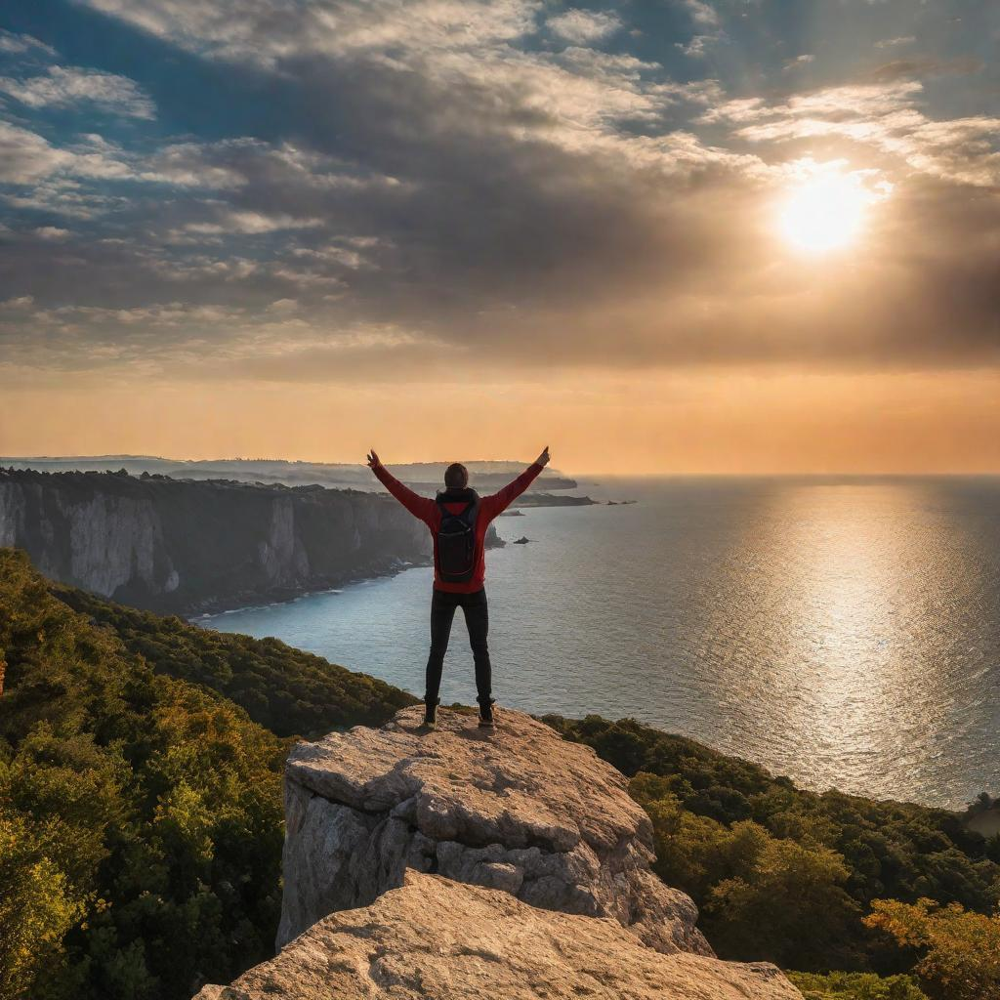
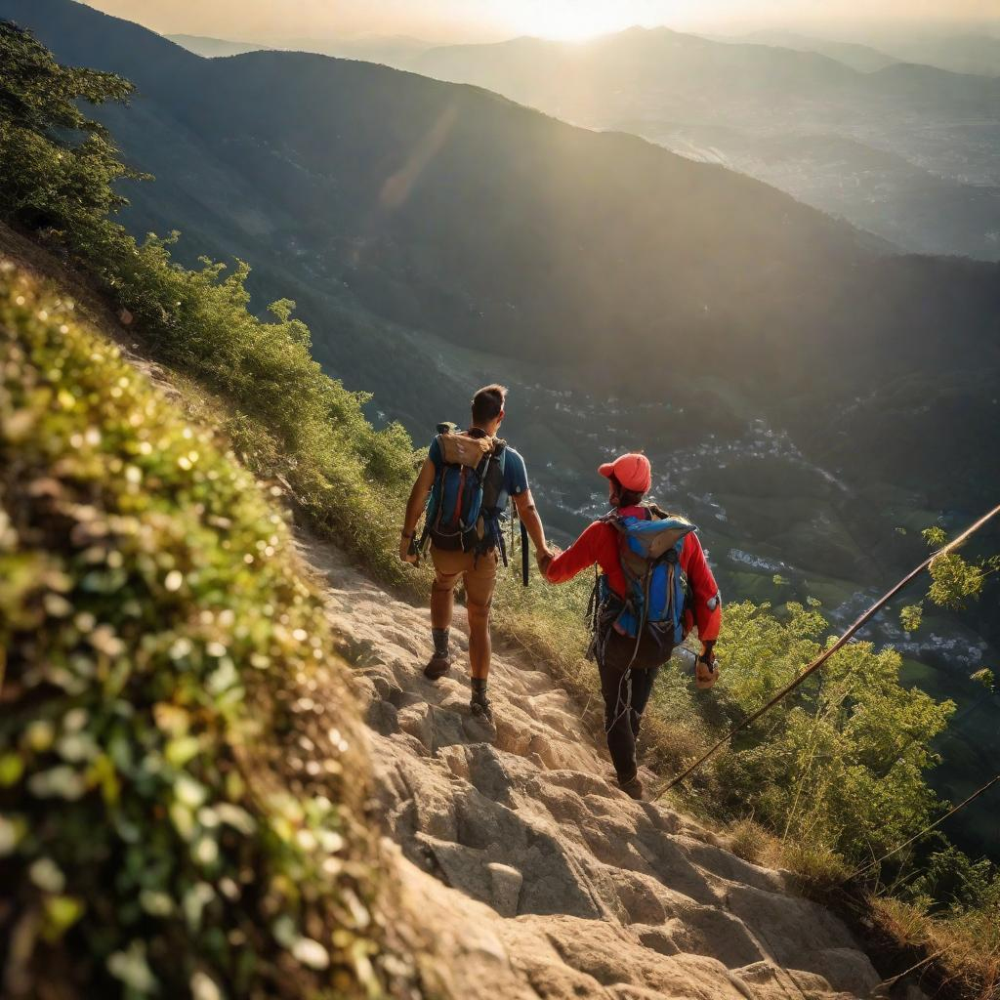
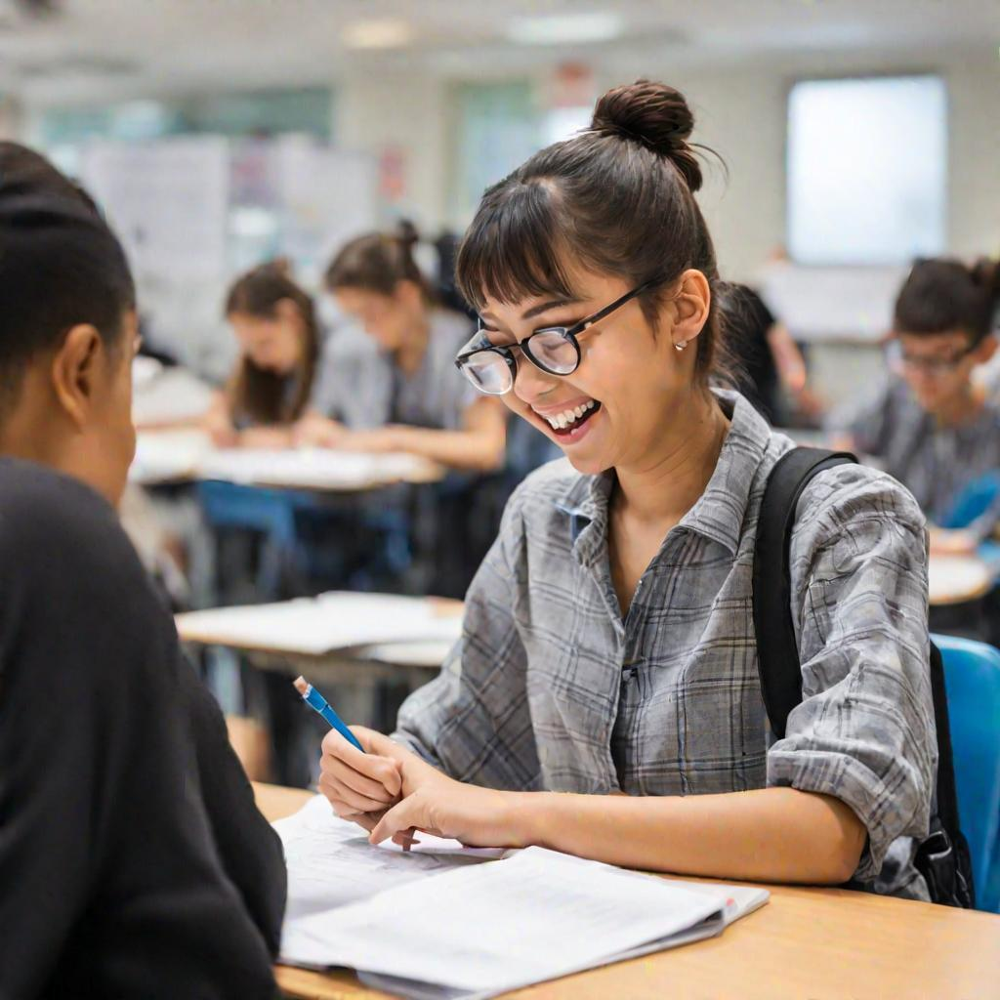
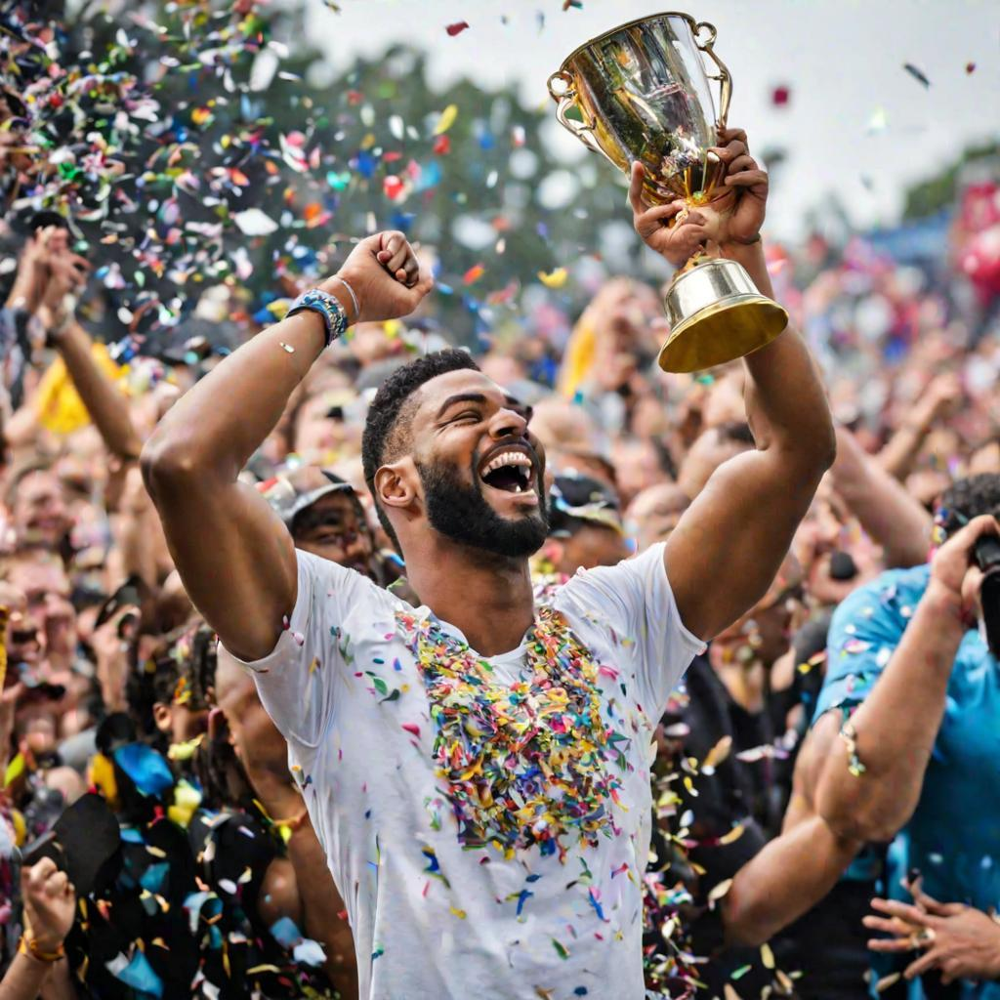
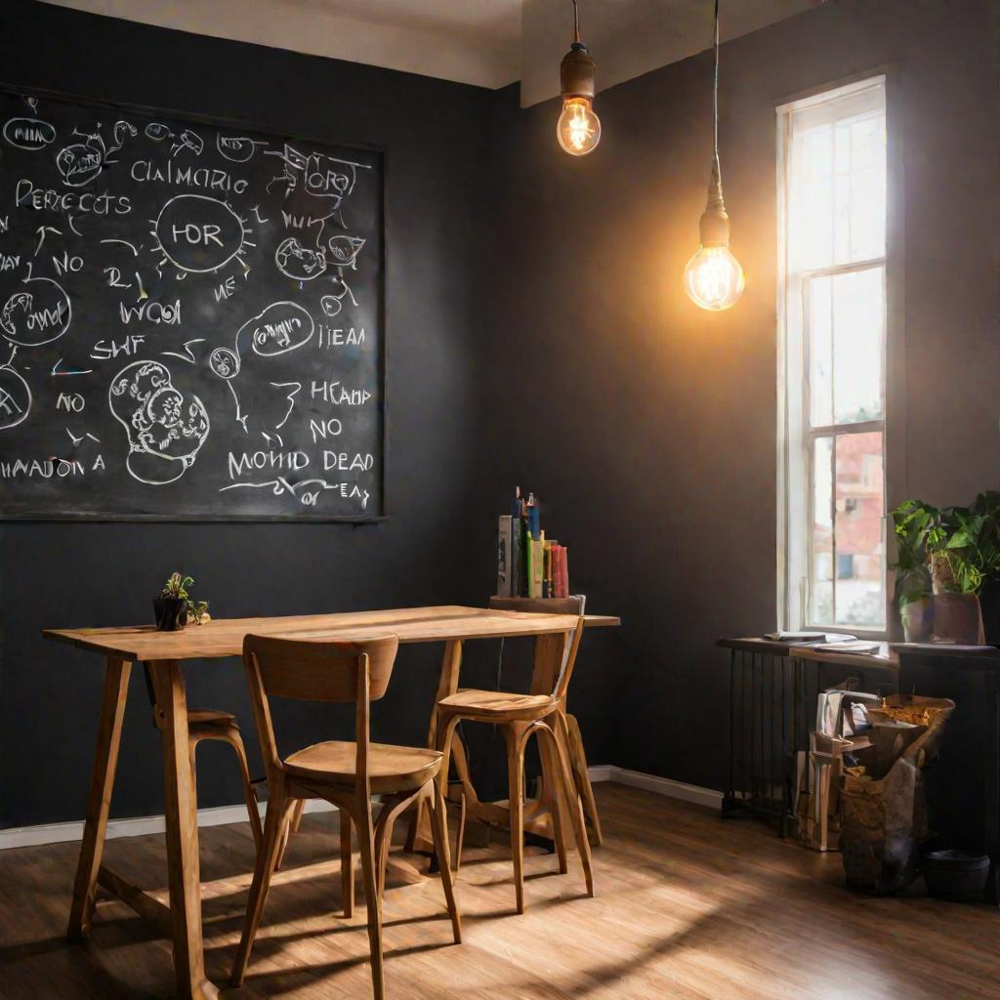
...
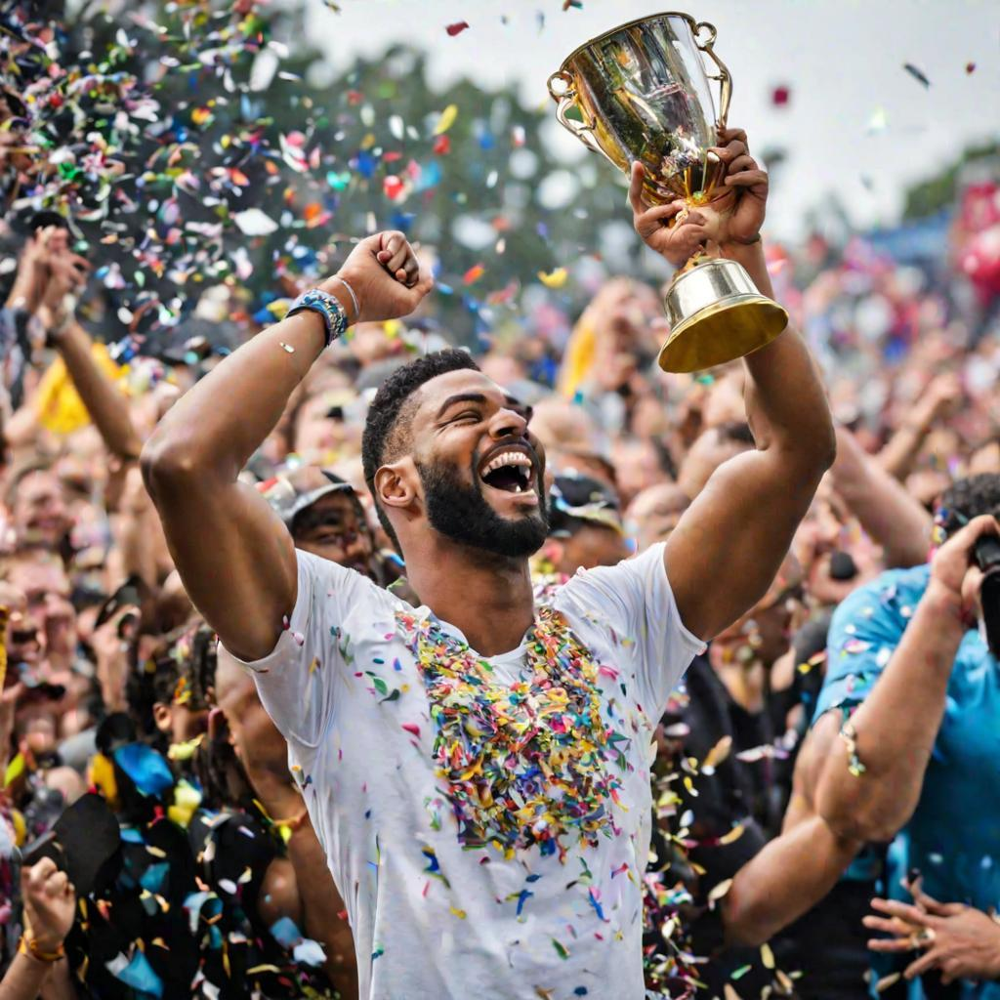
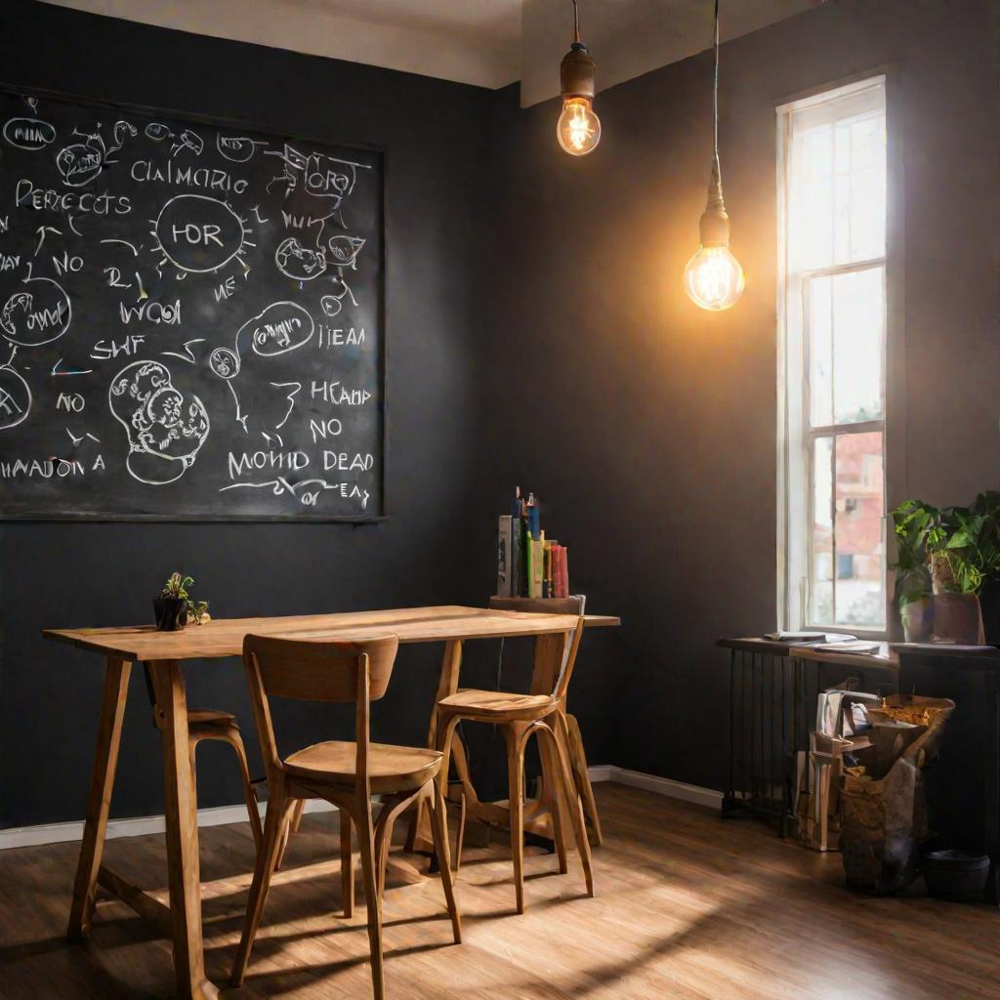
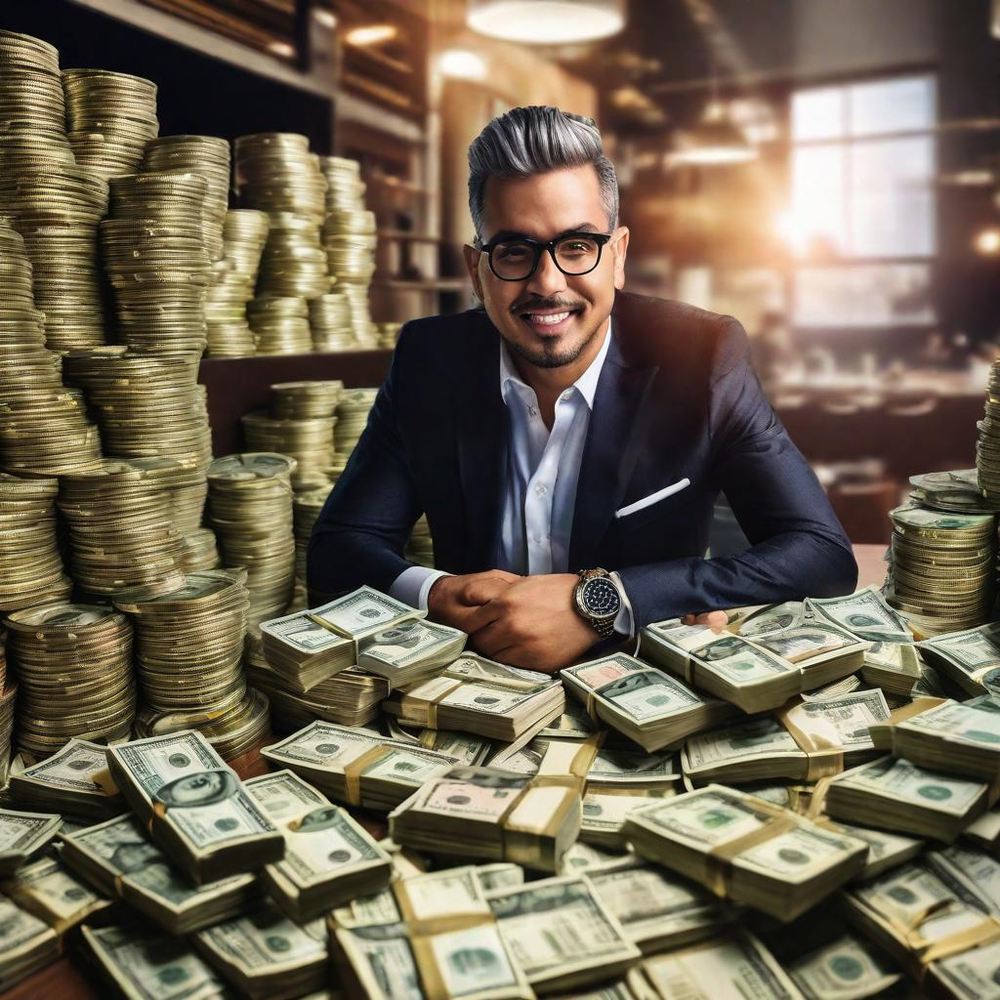
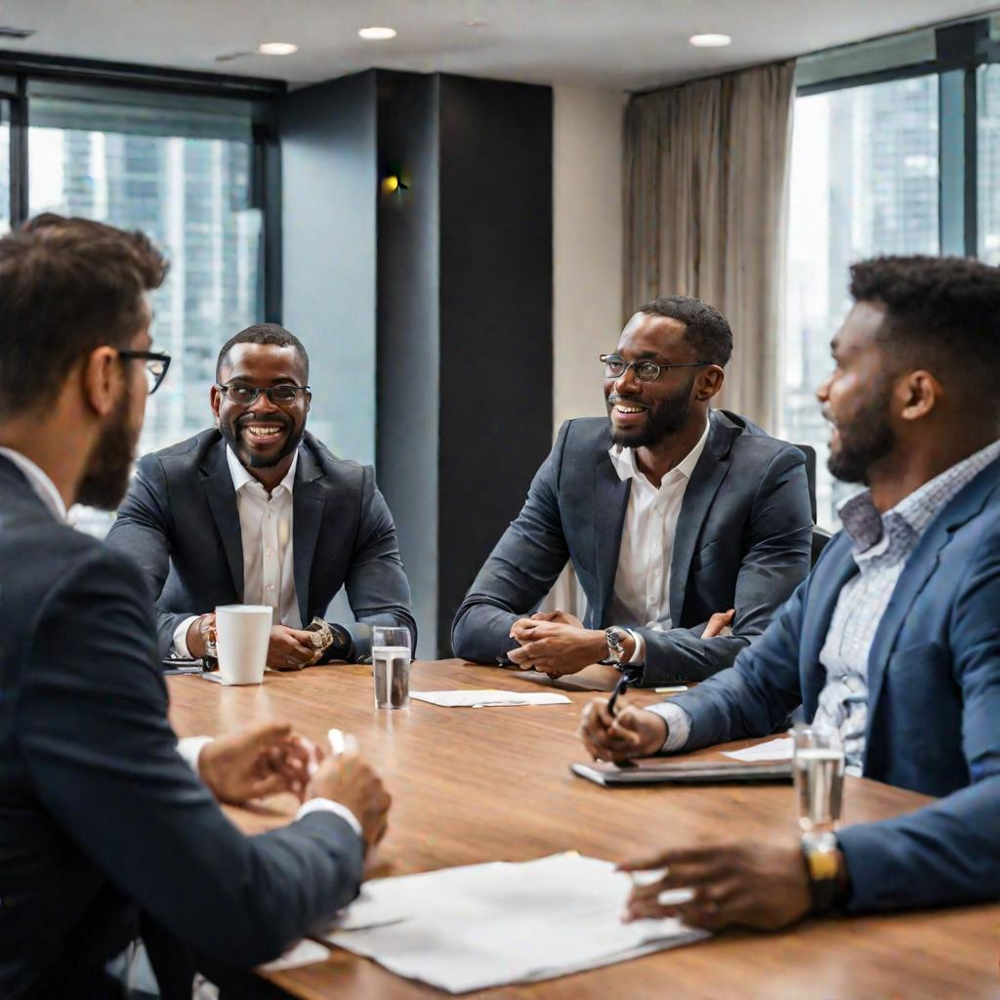
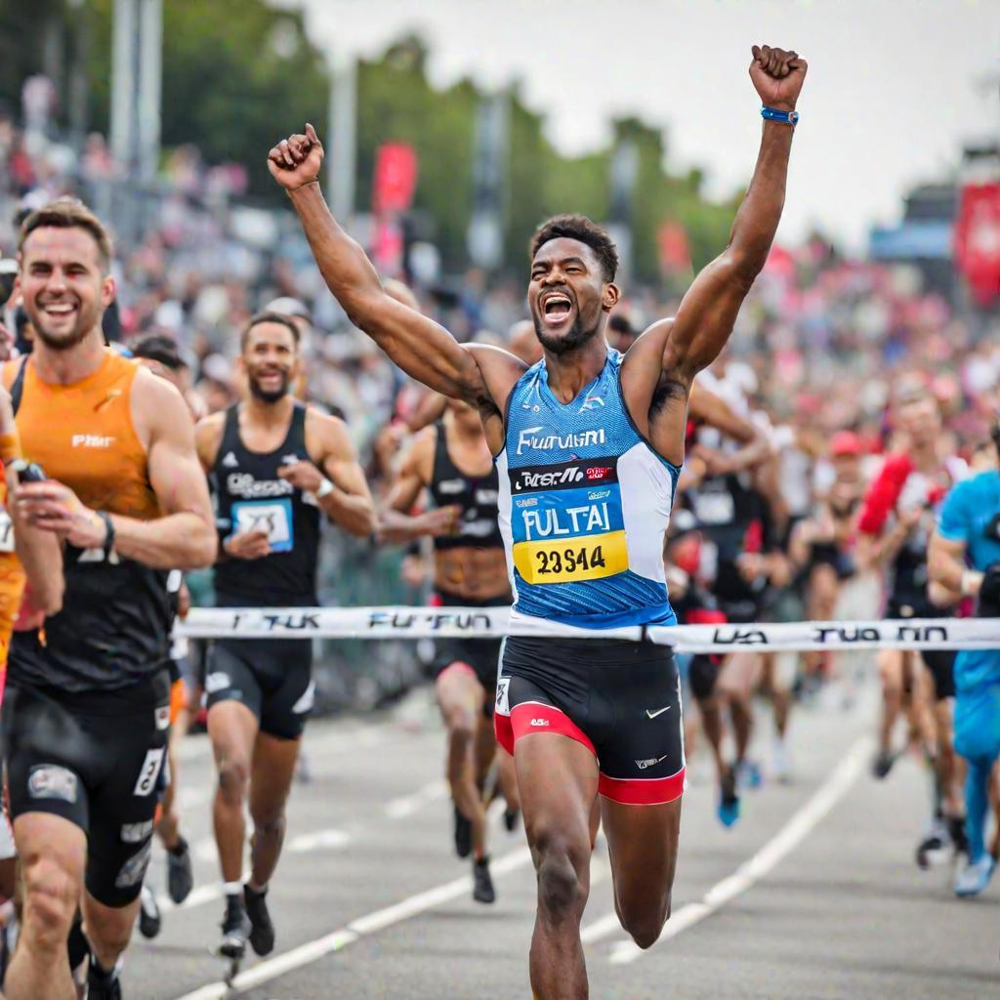

time: 5.9 s (started: 2023-08-27 10:48:03 +00:00)


In [ ]:
import ipyplot
ipyplot.plot_images(images,labels=image_prompts,img_width = 300)

## 3. Convert text to speech using [Elevenlabs](https://elevenlabs.io/) API

In [ ]:
elevenlabsapi = getpass('Enter the openai key: ')

Enter the openai key: ··········
time: 3.47 s (started: 2023-08-27 10:53:07 +00:00)


In [ ]:
import requests

def generate_and_save_audio(text, foldername, filename, voice_id, elevenlabs_apikey, model_id="eleven_multilingual_v2", stability=0.4, similarity_boost=0.80):
    url = f"https://api.elevenlabs.io/v1/text-to-speech/{voice_id}"
    headers = {
        "Accept": "audio/mpeg",
        "Content-Type": "application/json",
        "xi-api-key": elevenlabs_apikey
    }

    data = {
        "text": text,
        "model_id": model_id,
        "voice_settings": {
            "stability": stability,
            "similarity_boost": similarity_boost
        }
    }

    response = requests.post(url, json=data, headers=headers)

    if response.status_code != 200:
        print(response.text)
    else:
        file_path = f"{foldername}/{filename}.mp3"
        with open(file_path, 'wb') as f:
            f.write(response.content)

time: 1.27 ms (started: 2023-08-27 10:54:23 +00:00)


In [ ]:
print (texts)

['Embrace the challenges. They are stepping stones towards greatness.', 'Success is never a solitary journey. Surround yourself with a network of support.', "Celebrate your wins, no matter how big or small. You've worked hard, and you deserve it.", 'Capture the joy of victory. Your hard work and determination have paid off.', 'Leave your comfort zone. Innovation and success await on the other side.', 'Achieve your financial goals. Take smart risks, and the rewards will follow.', 'Success thrives in collaboration. Embrace different perspectives to unlock your full potential.', 'Persist. Keep pushing forward, and victory will be within your grasp.']
time: 1.54 ms (started: 2023-08-27 10:54:27 +00:00)


In [ ]:

voice_id = "pNInz6obpgDQGcFmaJgB"
for i, text in enumerate(texts):
  output_filename= str(i + 1)
  print (output_filename)
  generate_and_save_audio(text, current_foldername, output_filename, voice_id, elevenlabsapi)

1
2
3
4
5
6
7
8
time: 23.1 s (started: 2023-08-27 10:54:57 +00:00)


## 4. Install Moviepy to stitch everything

In [ ]:
!pip install --quiet git+https://github.com/Zulko/moviepy.git@bc8d1a831d2d1f61abfdf1779e8df95d523947a5
!pip install --quiet imageio==2.25.1

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 17.2 MB/s eta 0:00:00
time: 17.5 s (started: 2023-08-27 10:56:15 +00:00)


In [ ]:
!apt install -qq imagemagick

The following additional packages will be installed:
  fonts-droid-fallback fonts-noto-mono fonts-urw-base35 ghostscript gsfonts
  imagemagick-6-common imagemagick-6.q16 libdjvulibre-text libdjvulibre21
  libfftw3-double3 libgs9 libgs9-common libidn12 libijs-0.35 libjbig2dec0
  libjxr-tools libjxr0 liblqr-1-0 libmagickcore-6.q16-6
  libmagickcore-6.q16-6-extra libmagickwand-6.q16-6 libnetpbm10
  libwmflite-0.2-7 netpbm poppler-data
Suggested packages:
  fonts-noto fonts-freefont-otf | fonts-freefont-ttf fonts-texgyre
  ghostscript-x imagemagick-doc autotrace cups-bsd | lpr | lprng enscript gimp
  gnuplot grads hp2xx html2ps libwmf-bin mplayer povray radiance sane-utils
  texlive-base-bin transfig ufraw-batch libfftw3-bin libfftw3-dev inkscape
  poppler-utils fonts-japanese-mincho | fonts-ipafont-mincho
  fonts-japanese-gothic | fonts-ipafont-gothic fonts-arphic-ukai
  fonts-arphic-uming fonts-nanum
The following NEW packages will be installed:
  fonts-droid-fallback fonts-noto-mono fon

In [ ]:
!cat /etc/ImageMagick-6/policy.xml | sed 's/none/read,write/g'> /etc/ImageMagick-6/policy.xml

time: 126 ms (started: 2023-08-27 10:56:54 +00:00)


In [ ]:
from moviepy.editor import AudioFileClip, concatenate_audioclips, concatenate_videoclips, ImageClip
import os
import cv2
import numpy as np

def create_combined_video_audio(mp3_folder, output_filename, output_resolution=(1080, 1920), fps=24):
    mp3_files = sorted([file for file in os.listdir(mp3_folder) if file.endswith(".mp3")])
    mp3_files = sorted(mp3_files, key=lambda x: int(x.split('.')[0]))

    audio_clips = []
    video_clips = []

    for mp3_file in mp3_files:
        audio_clip = AudioFileClip(os.path.join(mp3_folder, mp3_file))
        audio_clips.append(audio_clip)

        # Load the corresponding image for each mp3 and set its duration to match the mp3's duration
        img_path = os.path.join(mp3_folder, f"{mp3_file.split('.')[0]}.jpg")
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB format

        # Resize the original image to 1080x1080
        image_resized = cv2.resize(image, (1080, 1080))

        # Blur the image
        blurred_img = cv2.GaussianBlur(image, (0, 0), 30)
        blurred_img = cv2.resize(blurred_img, output_resolution)

        # Overlay the original image on the blurred one
        y_offset = (output_resolution[1] - 1080) // 2
        blurred_img[y_offset:y_offset+1080, :] = image_resized

        video_clip = ImageClip(np.array(blurred_img), duration=audio_clip.duration)
        video_clips.append(video_clip)

    final_audio = concatenate_audioclips(audio_clips)
    final_video = concatenate_videoclips(video_clips, method="compose")
    final_video = final_video.with_audio(final_audio)
    finalpath = mp3_folder+"/"+output_filename

    final_video.write_videofile(finalpath, fps=fps, codec='libx264',audio_codec="aac")




time: 1.47 s (started: 2023-08-27 10:57:36 +00:00)


In [ ]:
output_filename = "combined_video.mp4"
create_combined_video_audio(current_foldername, output_filename)

MoviePy - Building video ff3da95d-44f7-40a5-b758-5c3664c31792/combined_video.mp4.
MoviePy - Writing audio in combined_videoTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
MoviePy - Writing video ff3da95d-44f7-40a5-b758-5c3664c31792/combined_video.mp4



MoviePy - Done !
MoviePy - video ready ff3da95d-44f7-40a5-b758-5c3664c31792/combined_video.mp4
time: 1min 29s (started: 2023-08-27 10:58:07 +00:00)


In [ ]:
from IPython.display import HTML
from base64 import b64encode

output_video_file = current_foldername+"/"+output_filename
mp4 = open(output_video_file,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=600 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

time: 80.3 ms (started: 2023-08-27 10:59:55 +00:00)


## 5. Extract word level timestamps to overlap captions on top of the video

In [ ]:
!pip install ffmpeg-python==0.2.0

time: 5.44 s (started: 2023-08-27 11:01:06 +00:00)


In [ ]:
import ffmpeg

def extract_audio_from_video(outvideo):
    """
    Extract audio from a video file and save it as an MP3 file.

    :param output_video_file: Path to the video file.
    :return: Path to the generated audio file.
    """

    audiofilename = outvideo.replace(".mp4",'.mp3')

    # Create the ffmpeg input stream
    input_stream = ffmpeg.input(outvideo)

    # Extract the audio stream from the input stream
    audio = input_stream.audio

    # Save the audio stream as an MP3 file
    output_stream = ffmpeg.output(audio, audiofilename)

    # Overwrite output file if it already exists
    output_stream = ffmpeg.overwrite_output(output_stream)

    ffmpeg.run(output_stream)

    return audiofilename



audiofilename = extract_audio_from_video(output_video_file)
print(audiofilename)




ff3da95d-44f7-40a5-b758-5c3664c31792/combined_video.mp3
time: 1.91 s (started: 2023-08-27 11:01:12 +00:00)


In [ ]:
from IPython.display import Audio

Audio(audiofilename)

time: 41 ms (started: 2023-08-27 11:01:16 +00:00)


In [ ]:
!pip install --quiet faster-whisper==0.7.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.0/31.0 MB 24.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.7/35.7 MB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 79.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 80.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 9.2 MB/s eta 0:00:00
time: 15.6 s (started: 2023-08-27 11:01:36 +00:00)


In [ ]:
from faster_whisper import WhisperModel

model_size = "medium"
model = WhisperModel(model_size)

time: 28.3 s (started: 2023-08-27 11:01:57 +00:00)


In [ ]:
segments, info = model.transcribe(audiofilename, word_timestamps=True)
segments = list(segments)  # The transcription will actually run here.
for segment in segments:
    for word in segment.words:
        print("[%.2fs -> %.2fs] %s" % (word.start, word.end, word.word))

[0.00s -> 0.62s]  Embrace
[0.62s -> 0.78s]  the
[0.78s -> 1.34s]  challenges.
[1.58s -> 1.70s]  They
[1.70s -> 1.98s]  are
[1.98s -> 2.24s]  stepping
[2.24s -> 2.76s]  stones
[2.76s -> 3.18s]  towards
[3.18s -> 3.80s]  greatness.
[4.36s -> 4.58s]  Success
[4.58s -> 4.82s]  is
[4.82s -> 5.14s]  never
[5.14s -> 5.34s]  a
[5.34s -> 5.88s]  solitary
[5.88s -> 6.36s]  journey.
[6.92s -> 7.24s]  Surround
[7.24s -> 7.68s]  yourself
[7.68s -> 7.86s]  with
[7.86s -> 8.06s]  a
[8.06s -> 8.36s]  network
[8.36s -> 8.64s]  of
[8.64s -> 9.12s]  support.
[9.48s -> 9.96s]  Celebrate
[9.96s -> 10.22s]  your
[10.22s -> 10.54s]  wins,
[10.74s -> 10.78s]  no
[10.78s -> 11.04s]  matter
[11.04s -> 11.44s]  how
[11.44s -> 11.58s]  big
[11.58s -> 11.92s]  or
[11.92s -> 12.22s]  small.
[12.46s -> 12.76s]  You've
[12.76s -> 12.94s]  worked
[12.94s -> 13.24s]  hard
[13.24s -> 13.40s]  and
[13.40s -> 13.70s]  you
[13.70s -> 13.96s]  deserve
[13.96s -> 14.18s]  it.
[14.48s -> 14.90s]  Capture
[14.90s -> 15.08s]  t

In [ ]:
wordlevel_info = []

for segment in segments:
    for word in segment.words:
      wordlevel_info.append({'word':word.word,'start':word.start,'end':word.end})

time: 1.2 ms (started: 2023-08-27 11:05:47 +00:00)


In [ ]:
wordlevel_info

[{'word': ' Embrace', 'start': 0.0, 'end': 0.62},
 {'word': ' the', 'start': 0.62, 'end': 0.78},
 {'word': ' challenges.', 'start': 0.78, 'end': 1.34},
 {'word': ' They', 'start': 1.58, 'end': 1.7},
 {'word': ' are', 'start': 1.7, 'end': 1.98},
 {'word': ' stepping', 'start': 1.98, 'end': 2.24},
 {'word': ' stones', 'start': 2.24, 'end': 2.76},
 {'word': ' towards', 'start': 2.76, 'end': 3.18},
 {'word': ' greatness.', 'start': 3.18, 'end': 3.8},
 {'word': ' Success', 'start': 4.36, 'end': 4.58},
 {'word': ' is', 'start': 4.58, 'end': 4.82},
 {'word': ' never', 'start': 4.82, 'end': 5.14},
 {'word': ' a', 'start': 5.14, 'end': 5.34},
 {'word': ' solitary', 'start': 5.34, 'end': 5.88},
 {'word': ' journey.', 'start': 5.88, 'end': 6.36},
 {'word': ' Surround', 'start': 6.92, 'end': 7.24},
 {'word': ' yourself', 'start': 7.24, 'end': 7.68},
 {'word': ' with', 'start': 7.68, 'end': 7.86},
 {'word': ' a', 'start': 7.86, 'end': 8.06},
 {'word': ' network', 'start': 8.06, 'end': 8.36},
 {'wor

time: 18.8 ms (started: 2023-08-27 11:05:49 +00:00)


In [ ]:
from moviepy.editor import VideoFileClip, TextClip, CompositeVideoClip

# Load the video file
video = VideoFileClip(output_video_file)

# Function to generate text clips
def generate_text_clip(word, start, end, video):
    txt_clip = (TextClip(word,font_size=80,color='white',font = "Nimbus-Sans-Bold",stroke_width=3, stroke_color='black').with_position('center')
               .with_duration(end - start))

    return txt_clip.with_start(start)

# Generate a list of text clips based on timestamps
clips = [generate_text_clip(item['word'], item['start'], item['end'], video) for item in wordlevel_info]

# Overlay the text clips on the video
final_video = CompositeVideoClip([video] + clips)

finalvideoname = current_foldername+"/"+"final.mp4"
# Write the result to a file
final_video.write_videofile(finalvideoname, codec="libx264",audio_codec="aac")


MoviePy - Building video ff3da95d-44f7-40a5-b758-5c3664c31792/final.mp4.
MoviePy - Writing audio in finalTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
MoviePy - Writing video ff3da95d-44f7-40a5-b758-5c3664c31792/final.mp4



frame_index: 100%|█████████▉| 930/931 [01:35<00:00,  8.55it/s, now=None]/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:154: UserWarning: In file ff3da95d-44f7-40a5-b758-5c3664c31792/combined_video.mp4, 6220800 bytes wanted but 0 bytes read at frame index 930 (out of a total 931 frames), at time 38.75/38.80 sec. Using the last valid frame instead.
  warnings.warn(


MoviePy - Done !
MoviePy - video ready ff3da95d-44f7-40a5-b758-5c3664c31792/final.mp4
time: 1min 44s (started: 2023-08-27 11:06:14 +00:00)


In [ ]:
from IPython.display import HTML
from base64 import b64encode

mp4 = open(finalvideoname,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=600 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

time: 84.7 ms (started: 2023-08-27 11:08:06 +00:00)


In [ ]:
from moviepy.editor import TextClip

# Get the list of all fonts
fonts_list = TextClip.list('font')

# Print the fonts
for font in fonts_list:
    print(font)


## 6. Build UI with Gradio for automation

If you have run them already above, don't run the installation and setup steps below again.

In [ ]:
!pip install --quiet git+https://github.com/Zulko/moviepy.git@bc8d1a831d2d1f61abfdf1779e8df95d523947a5
!pip install --quiet imageio==2.25.1

In [ ]:
!apt install -q imagemagick

In [ ]:
!cat /etc/ImageMagick-6/policy.xml | sed 's/none/read,write/g'> /etc/ImageMagick-6/policy.xml

In [ ]:
!pip install --quiet ffmpeg-python==0.2.0
!pip install --quiet faster-whisper==0.7.0

In [ ]:
!pip install --quiet gradio==3.41.2

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 30.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.2/66.2 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.2/298.2 kB 23.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.4/75.4 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.9/139.9 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.5/59.5 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.5/74.5 kB 6.6 MB/s eta 0:00:00
time: 15.4 s (started: 2023-08-27 11:16:55 +00:00)


In [ ]:
from getpass import getpass
openaikey = getpass('Enter the openai key: ')


In [ ]:
segmind_apikey = getpass('Enter the openai key: ')

In [ ]:
elevenlabsapi = getpass('Enter the openai key: ')

In [ ]:
chatgpt_url = "https://api.openai.com/v1/chat/completions"
chatgpt_headers = {
    "content-type": "application/json",
    "Authorization":"Bearer {}".format(openaikey)}

In [ ]:
import requests
import json
from pprint import pprint

def fetch_imagedescription_and_script(prompt,url,headers):

    # Define the payload for the chat model
    messages = [
        {"role": "system", "content": "You are an expert short form video script writer for Instagram Reels and Youtube shorts."},
        {"role": "user", "content": prompt}
    ]

    chatgpt_payload = {
        "model": "gpt-3.5-turbo-16k",
        "messages": messages,
        "temperature": 1.3,
        "max_tokens": 2000,
        "top_p": 1,
        "stop": ["###"]
    }

    # Make the request to OpenAI's API
    response = requests.post(url, json=chatgpt_payload, headers=headers)
    response_json = response.json()

    # Extract data from the API's response
    output = json.loads(response_json['choices'][0]['message']['content'].strip())
    pprint (output)
    image_prompts = [k['image_description'] for k in output]
    texts = [k['text'] for k in output]

    return image_prompts, texts

time: 1.71 ms (started: 2023-08-27 11:14:55 +00:00)


In [ ]:
import os
import io
import requests
from PIL import Image
import random

def generate_images(prompts, fname):
    url = "https://api.segmind.com/v1/sdxl1.0-txt2img"

    headers = {'x-api-key': segmind_apikey}

    # Create a folder for the UUID if it doesn't exist
    if not os.path.exists(fname):
        os.makedirs(fname)

    num_images = len(prompts)

    currentseed = random.randint(1, 1000000)
    print ("seed ",currentseed)

    for i, prompt in enumerate(prompts):

        final_prompt = "((perfect quality)), ((cinematic photo:1.3)), ((raw candid)), 4k, {}, no occlusion, Fujifilm XT3, highly detailed, bokeh, cinemascope".format(prompt.strip('.'))
        data = {
            "prompt": final_prompt,
            "negative_prompt": "((deformed)), ((limbs cut off)), ((quotes)), ((extra fingers)), ((deformed hands)), extra limbs, disfigured, blurry, bad anatomy, absent limbs, blurred, watermark, disproportionate, grainy, signature, cut off, missing legs, missing arms, poorly drawn face, bad face, fused face, cloned face, worst face, three crus, extra crus, fused crus, worst feet, three feet, fused feet, fused thigh, three thigh, fused thigh, extra thigh, worst thigh, missing fingers, extra fingers, ugly fingers, long fingers, horn, extra eyes, amputation, disconnected limbs",
            "style": "hdr",
            "samples": 1,
            "scheduler": "UniPC",
            "num_inference_steps": 30,
            "guidance_scale": 8,
            "strength": 1,
            "seed": currentseed,
            "img_width": 1024,
            "img_height": 1024,
            "refiner": "yes",
            "base64": False
                  }

        response = requests.post(url, json=data, headers=headers)

        if response.status_code == 200 and response.headers.get('content-type') == 'image/jpeg':
            image_data = response.content
            image = Image.open(io.BytesIO(image_data))

            image_filename = os.path.join(fname, f"{i + 1}.jpg")
            image.save(image_filename)

            print(f"Image {i + 1}/{num_images} saved as '{image_filename}'")
        else:
            print (response.text)
            print(f"Error: Failed to retrieve or save image {i + 1}")

time: 2.31 ms (started: 2023-08-27 11:14:58 +00:00)


In [ ]:
import requests
from moviepy.editor import AudioFileClip, concatenate_audioclips, concatenate_videoclips, ImageClip
from moviepy.editor import VideoFileClip, TextClip, CompositeVideoClip
import os
import cv2
import numpy as np
import ffmpeg

def generate_and_save_audio(text, foldername, filename, voice_id, elevenlabs_apikey, model_id="eleven_multilingual_v2", stability=0.4, similarity_boost=0.80):
    url = f"https://api.elevenlabs.io/v1/text-to-speech/{voice_id}"
    headers = {
        "Accept": "audio/mpeg",
        "Content-Type": "application/json",
        "xi-api-key": elevenlabs_apikey
    }

    data = {
        "text": text,
        "model_id": model_id,
        "voice_settings": {
            "stability": stability,
            "similarity_boost": similarity_boost
        }
    }

    response = requests.post(url, json=data, headers=headers)

    if response.status_code != 200:
        print(response.text)
    else:
        file_path = f"{foldername}/{filename}.mp3"
        with open(file_path, 'wb') as f:
            f.write(response.content)



def create_combined_video_audio(mp3_folder, output_filename, output_resolution=(1080, 1920), fps=24):
    mp3_files = sorted([file for file in os.listdir(mp3_folder) if file.endswith(".mp3")])
    mp3_files = sorted(mp3_files, key=lambda x: int(x.split('.')[0]))

    audio_clips = []
    video_clips = []

    for mp3_file in mp3_files:
        audio_clip = AudioFileClip(os.path.join(mp3_folder, mp3_file))
        audio_clips.append(audio_clip)

        # Load the corresponding image for each mp3 and set its duration to match the mp3's duration
        img_path = os.path.join(mp3_folder, f"{mp3_file.split('.')[0]}.jpg")
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB format

        # Resize the original image to 1080x1080
        image_resized = cv2.resize(image, (1080, 1080))

        # Blur the image
        blurred_img = cv2.GaussianBlur(image, (0, 0), 30)
        blurred_img = cv2.resize(blurred_img, output_resolution)

        # Overlay the original image on the blurred one
        y_offset = (output_resolution[1] - 1080) // 2
        blurred_img[y_offset:y_offset+1080, :] = image_resized

        video_clip = ImageClip(np.array(blurred_img), duration=audio_clip.duration)
        video_clips.append(video_clip)

    final_audio = concatenate_audioclips(audio_clips)
    final_video = concatenate_videoclips(video_clips, method="compose")
    final_video = final_video.with_audio(final_audio)
    finalpath = mp3_folder+"/"+output_filename

    final_video.write_videofile(finalpath, fps=fps, codec='libx264',audio_codec="aac")

def extract_audio_from_video(outvideo):
    """
    Extract audio from a video file and save it as an MP3 file.

    :param output_video_file: Path to the video file.
    :return: Path to the generated audio file.
    """

    audiofilename = outvideo.replace(".mp4",'.mp3')

    # Create the ffmpeg input stream
    input_stream = ffmpeg.input(outvideo)

    # Extract the audio stream from the input stream
    audio = input_stream.audio

    # Save the audio stream as an MP3 file
    output_stream = ffmpeg.output(audio, audiofilename)

    # Overwrite output file if it already exists
    output_stream = ffmpeg.overwrite_output(output_stream)

    ffmpeg.run(output_stream)

    return audiofilename

# Function to generate text clips
def generate_text_clip(word, start, end, video):
    txt_clip = (TextClip(word,font_size=80,color='white',font = "Nimbus-Sans-Bold",stroke_width=3, stroke_color='black').with_position('center')
               .with_duration(end - start))

    return txt_clip.with_start(start)


time: 2.78 ms (started: 2023-08-27 11:15:01 +00:00)


In [ ]:
def get_word_level_timestamps(model,audioname):
  segments, info = model.transcribe(audioname, word_timestamps=True)
  segments = list(segments)  # The transcription will actually run here.
  wordlevel_info=[]
  for segment in segments:
    for word in segment.words:
      wordlevel_info.append({'word':word.word,'start':word.start,'end':word.end})
  return wordlevel_info

time: 844 µs (started: 2023-08-27 11:15:06 +00:00)


In [ ]:
from faster_whisper import WhisperModel

model_size = "medium"
model = WhisperModel(model_size)

time: 9.69 s (started: 2023-08-27 11:15:14 +00:00)


In [ ]:
import os

def add_captions_to_video(videofilename,wordlevelcaptions):
  # Load the video file
  video = VideoFileClip(videofilename)

  # Generate a list of text clips based on timestamps
  clips = [generate_text_clip(item['word'], item['start'], item['end'], video) for item in wordlevelcaptions]

  # Overlay the text clips on the video
  final_video = CompositeVideoClip([video] + clips)

  path, old_filename = os.path.split(videofilename)

  finalvideoname = path+"/"+"final.mp4"
  # Write the result to a file
  final_video.write_videofile(finalvideoname, codec="libx264",audio_codec="aac")

  return finalvideoname

time: 7.78 ms (started: 2023-08-27 11:15:23 +00:00)


In [ ]:
topics = [
    "Success and Achievement",
    "Morning Afformations",
    "Self-Care and Wellness",
    "Gratitude and Positivity",
    "Boost Confidence",
    "Happiness and Joy",
    "Resilience and Adversity",
    "Relationships and Connections",
    "Mindfulness and Presence",
    "Empowerment",
    "Time Management and Productivity"
]

topics_goals = {
    "Success and Achievement": "Inspire people to overcome challenges, achieve success, and celebrate their victories",
    "Morning Afformations": "Encourage viewers to start their day with a positive mindset.",
    "Self-Care and Wellness": "Offer tips and reminders for self-care practices, stress reduction, and maintaining overall well-being",
    "Gratitude and Positivity": "Emphasize gratitude and positive thinking",
    "Boost Confidence": "Help build self-confidence and self-esteem",
    "Happiness and Joy": "Help people find happiness in simple moments and enjoy life's journey",
    "Resilience and Adversity": "Help build resilience in the face of adversity",
    "Relationships and Connections": "Help build meaningful relationships, foster connections, and spread love",
    "Mindfulness and Presence": "Encourage mindfulness and being present in the moment",
    "Empowerment": "Empower viewers to take control of their lives, make positive choices, and pursue their dreams",
    "Time Management and Productivity": "Provide tips about managing time effectively, staying organized, and being productive"
}


time: 1.06 ms (started: 2023-08-27 11:15:40 +00:00)


In [ ]:
import uuid


def create_video(inp):
  topic = inp
  goal = topics_goals[inp]
  prompt_prefix = """You are tasked with creating a script for a {} video that is about 30 seconds.
Your goal is to {}.
Please follow these instructions to create an engaging and impactful video:
1. Begin by setting the scene and capturing the viewer's attention with a captivating visual.
2. Each scene cut should occur every 5-10 seconds, ensuring a smooth flow and transition throughout the video.
3. For each scene cut, provide a detailed description of the stock image being shown.
4. Along with each image description, include a corresponding text that complements and enhances the visual. The text should be concise and powerful.
5. Ensure that the sequence of images and text builds excitement and encourages viewers to take action.
6. Strictly output your response in a JSON list format, adhering to the following sample structure:""".format(topic,goal)

  sample_output="""
    [
        { "image_description": "Description of the first image here.", "text": "Text accompanying the first scene cut." },
        { "image_description": "Description of the second image here.", "text": "Text accompanying the second scene cut." },
        ...
    ]"""

  prompt_postinstruction="""By following these instructions, you will create an impactful {} short-form video.
  Output:""".format(topic)

  prompt = prompt_prefix + sample_output + prompt_postinstruction

  image_prompts, texts = fetch_imagedescription_and_script(prompt,chatgpt_url,chatgpt_headers)

  current_uuid = uuid.uuid4()
  current_foldername = str(current_uuid)

  generate_images(image_prompts, current_foldername)

  # images = read_images_from_folder(current_foldername)

  voice_id = "pNInz6obpgDQGcFmaJgB"
  for i, text in enumerate(texts):
    output_filename= str(i + 1)
    print (output_filename)
    generate_and_save_audio(text, current_foldername, output_filename, voice_id, elevenlabsapi)

  output_filename = "combined_video.mp4"
  create_combined_video_audio(current_foldername, output_filename)
  output_video_file = current_foldername+"/"+output_filename

  return output_video_file

def add_captions(inputvideo):
  print(inputvideo)
  audiofilename = extract_audio_from_video(inputvideo)
  print (audiofilename)
  wordlevelinfo = get_word_level_timestamps(model,audiofilename)
  print (wordlevelinfo)
  finalvidpath = add_captions_to_video(inputvideo,wordlevelinfo)
  print (finalvidpath)

  return finalvidpath




time: 1.78 ms (started: 2023-08-27 11:15:45 +00:00)


Main Gradio UI

In [ ]:
import gradio as gr


with gr.Blocks() as demo:
  gr.Markdown("# Generate shortform videos for Youtube Shorts or Instagram Reels")
  genre = gr.Dropdown(topics,value="Success and Achievement")
  btn_create_video = gr.Button('Generate Video')
  with gr.Row():
    with gr.Column():
      video = gr.Video(format='mp4',height=720,width = 405)
    with gr.Column():
      btn_add_captions = gr.Button('Add Captions')
    with gr.Column():
      finalvideo = gr.Video(format='mp4',height=720,width = 405)
  # btn_create_video.click(fn=create_video,inputs=[genre],outputs=[gallery])
  # gallery = gr.Gallery(label="images",columns=3)
  btn_create_video.click(fn=create_video,inputs=[genre],outputs=[video])
  btn_add_captions.click(fn=add_captions,inputs=[video],outputs=[finalvideo])

demo.launch(debug=True,enable_queue=True)

<ipython-input-51-4ddae9154714>:20: GradioDeprecationWarning: The `enable_queue` parameter has been deprecated. Please use the `.queue()` method instead.
  demo.launch(debug=True,enable_queue=True)


Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://c741bef4dd5646a1c7.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


[{'image_description': 'A vibrant sunset by the beach, casting a golden hue on '
                       'the ocean waves.',
  'text': 'Step outside and immerse yourself in the beauty of nature. Take a '
          'moment to appreciate its calming embrace.'},
 {'image_description': 'A pair of hands cradling a steaming cup of herbal tea.',
  'text': 'Savor the warmth and tranquility of a comforting beverage. Let its '
          'aroma soothe your senses and ignite relaxation.'},
 {'image_description': 'A serene spa environment with glowing candles and '
                       'aromatic essential oils.',
  'text': 'Create your personal haven of serenity. Surround yourself with '
          'calmness and create an atmosphere that restores your spirit.'},
 {'image_description': 'An outline of a person relaxing in a yoga posture '
                       'against a backdrop of a majestic mountain range.',
  'text': 'Unwind your body, strengthen your mind. Find solace in gentle '
          'mov

MoviePy - Done.
MoviePy - Writing video 6b310da4-24d8-47fe-8d45-aa83046800ae/combined_video.mp4



MoviePy - Done !
MoviePy - video ready 6b310da4-24d8-47fe-8d45-aa83046800ae/combined_video.mp4
/tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/combined_video.mp4
/tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/combined_video.mp3
[{'word': ' Step', 'start': 0.0, 'end': 0.34}, {'word': ' outside', 'start': 0.34, 'end': 0.94}, {'word': ' and', 'start': 0.94, 'end': 1.18}, {'word': ' immerse', 'start': 1.18, 'end': 1.5}, {'word': ' yourself', 'start': 1.5, 'end': 1.84}, {'word': ' in', 'start': 1.84, 'end': 1.96}, {'word': ' the', 'start': 1.96, 'end': 2.18}, {'word': ' beauty', 'start': 2.18, 'end': 2.38}, {'word': ' of', 'start': 2.38, 'end': 2.6}, {'word': ' nature.', 'start': 2.6, 'end': 2.96}, {'word': ' Take', 'start': 3.58, 'end': 3.76}, {'word': ' a', 'start': 3.76, 'end': 3.96}, {'word': ' moment', 'start': 3.96, 'end': 4.18}, {'word': ' to', 'start': 4.18, 'end': 4.5}, {'word': ' appreciate', 'start': 4.5, 'end': 5.02}, {'word': ' its', 'start': 5.02, 'end': 5.36}, {'wo

MoviePy - Done.
MoviePy - Writing video /tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/final.mp4



frame_index: 100%|█████████▉| 1887/1888 [03:11<00:00, 11.45it/s, now=None]/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:154: UserWarning: In file /tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/combined_video.mp4, 6220800 bytes wanted but 0 bytes read at frame index 1887 (out of a total 1888 frames), at time 78.62/78.68 sec. Using the last valid frame instead.
  warnings.warn(


MoviePy - Done !
MoviePy - video ready /tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/final.mp4
/tmp/gradio/779caa5417eae4ba82020412300107e3932a7660/final.mp4
Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://c741bef4dd5646a1c7.gradio.live


time: 28min 26s (started: 2023-08-27 11:17:19 +00:00)
